# Imports

In [1]:
#Imports

#Data
import pandas as pd
import numpy as np

#Date
import datetime as dt
from datetime import datetime

#Visualisation
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

#ML
from imblearn.under_sampling import RandomUnderSampler

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler


from sklearn.metrics import mean_squared_error, mean_absolute_error

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
import xgboost as xgb
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
import tensorflow as tf
from sklearn.neural_network import MLPRegressor
from sklearn import datasets
from sklearn.datasets import make_regression
from sklearn.metrics import confusion_matrix,classification_report

from sklearn.preprocessing import OneHotEncoder

#Notebook
#pd.set_option("display.max_rows", None)
mpl.rcParams['agg.path.chunksize'] = 10000
pd.set_option('display.max_columns', None)

C:\Users\mmoy\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\xgboost\compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


In [5]:
df=pd.read_csv('data/xyz_corp_lending_data.csv',sep='\t')

C:\Users\mmoy\AppData\Local\Temp\ipykernel_18732\3365568958.py:1: DtypeWarning: Columns (17,45,53) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('data/xyz_corp_lending_data.csv',sep='\t')


In [6]:
df=df[df['desc'].isna()==False]

In [7]:
df=df[['desc','purpose']]

In [9]:
df['purpose'].value_counts()

debt_consolidation    69638
credit_card           25595
home_improvement       7276
other                  6688
major_purchase         3151
small_business         2648
car                    1955
wedding                1236
medical                1007
house                   833
moving                  791
vacation                573
educational             291
renewable_energy        130
Name: purpose, dtype: int64

In [ ]:
df['desc'].str.split('>')

['  Borrower added on 12/22/11 ',
 ' I plan to use this money to finance the motorcycle i am looking at. I plan to have it paid off as soon as possible/when i sell my old bike. I only need this money because the deal im looking at is to good to pass up.<br',
 '<br',
 '  Borrower added on 12/22/11 ',
 ' I plan to use this money to finance the motorcycle i am looking at. I plan to have it paid off as soon as possible/when i sell my old bike.I only need this money because the deal im looking at is to good to pass up. I have finished college with an associates degree in business and its takingmeplaces<br',
 '']

In [ ]:
df.loc[855550]

desc       I am in my senior year of college in obtaining...
purpose                                                other
Name: 855550, dtype: object

In [8]:
df['desc'].value_counts()

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               231
  Borrower added on 03/10/14 > Debt consolidation<br>                                                                                                                                                                                                                                                                                                                                                                                                                

# Core

In [2]:
#Core - Read CSV file
df=pd.read_csv('data/xyz_corp_lending_data.csv',sep='\t')

#Core - Drop columns (to be explained why for each column)
df=df.drop(['policy_code','funded_amnt','funded_amnt_inv','out_prncp_inv','total_pymnt_inv','id','member_id','total_rec_prncp','policy_code','installment','pymnt_plan','application_type','next_pymnt_d','title','emp_title'],axis=1)

#Core - Creating a metric to get % of null values and selecting the columns that have less than 50%
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
df=df[nullity[nullity<50].index]

#Core - Removing text from emp_length and term columns and converting to float
df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('float')

#Core - Converting Date Columns to YYYYMMDD format and float
date_cols=['last_pymnt_d','last_credit_pull_d','issue_d','earliest_cr_line']
for col in date_cols:
    df[col]=pd.to_datetime(df[col]).dt.strftime('%Y%m%d').astype(float)

#Filling na with median or mode
med=['tot_cur_bal','tot_coll_amt','total_rev_hi_lim','revol_util']
mod=['emp_length','last_pymnt_d','collections_12_mths_ex_med','last_credit_pull_d']
for col in med:
    df[col]=df[col].fillna(df[col].median())

for col in mod:
    df[col]=df[col].fillna(df[col].mode()[0])

#Cleaning up zip_code to only have numbers and concatenating with addr_state. Maybe remove add_state as zip_code already covers it
df['zip_code']=df['zip_code'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
#df['address']=df['zip_code']+df['addr_state']

#Encoding categorical values 
cat_columns=['purpose','verification_status','home_ownership','initial_list_status','addr_state','grade','sub_grade']
df[cat_columns] = df[cat_columns].astype('category').apply(lambda x: x.cat.codes)

#Cleaning outliers
df=df[(df['dti']<150)&(df['revol_util']<200)&(df['acc_now_delinq']<13)&(df['tot_coll_amt']<1000000)&(df['tot_cur_bal']<4000000)&(df['total_rev_hi_lim']<2000000)]#&(df['out_prncp']<35001)]

C:\Users\mmoy\AppData\Local\Temp\ipykernel_10856\1415614342.py:2: DtypeWarning: Columns (17,45,53) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('data/xyz_corp_lending_data.csv',sep='\t')
C:\Users\mmoy\AppData\Local\Temp\ipykernel_10856\1415614342.py:12: FutureWarning: The default value of regex will change from True to False in a future version.
  df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
C:\Users\mmoy\AppData\Local\Temp\ipykernel_10856\1415614342.py:13: FutureWarning: The default value of regex will change from True to False in a future version.
  df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
C:\Users\mmoy\AppData\Local\Temp\ipykernel_10856\1415614342.py:30: FutureWarning: The default value of regex will change from True to False in a future version.
  df['zip_code']=df['zip_code'].str.replace('[A-Za-z\s+<>]+', '').astype('float')


In [9]:
dfi=df[df['collection_recovery_fee']==0]

In [10]:
dfi['recoveries'].value_counts()

0.00        831766
10.20            6
16.50            6
13.20            6
10.40            6
             ...  
13.47            1
705.60           1
20.17            1
10.59            1
12679.50         1
Name: recoveries, Length: 818, dtype: int64

In [11]:
df['loan_amnt'].value_counts()

10000.0    59793
12000.0    48617
15000.0    45654
20000.0    45351
35000.0    34849
           ...  
750.0          1
950.0          1
700.0          1
725.0          1
800.0          1
Name: loan_amnt, Length: 1368, dtype: int64

In [19]:
df['recoveriess']=df['recoveries'].where(df['recoveries']==0,1)

In [21]:
df['recoveries'].value_counts()

0.00       831766
200.00         10
11.70           9
14.28           9
10.40           8
            ...  
1718.67         1
690.76          1
953.27          1
2152.39         1
5834.18         1
Name: recoveries, Length: 22627, dtype: int64

In [23]:
df[df['recoveries']<0].value_counts()

Series([], dtype: int64)

In [14]:
df[df['recoveries']!=0][['recoveries','collection_recovery_fee']]

,recoveries,collection_recovery_fee
1,117.08,1.1100
8,189.06,2.0900
9,269.29,2.5200
12,444.30,4.1600
14,645.10,6.3145
...,...,...
855055,3472.03,624.9654
855257,21941.26,571.1058
855548,1413.48,254.4264
855710,5834.18,1050.1524


<AxesSubplot:xlabel='recoveries', ylabel='Count'>

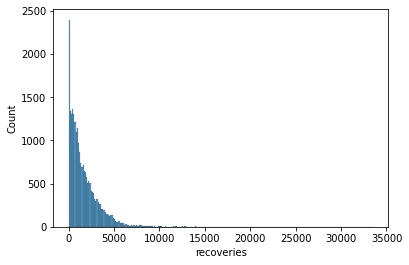

In [13]:
sns.histplot(df[df['recoveries']!=0]['recoveries'])

In [12]:
df[df['default_ind']==1]['recoveries'].value_counts()

0.00       22280
200.00        10
11.70          9
14.28          9
100.00         8
           ...  
2219.00        1
1718.67        1
690.76         1
953.27         1
5834.18        1
Name: recoveries, Length: 22627, dtype: int64

Model Build - Classification

Variables Highly predicting the model
Out_prncp
Last_pymnt_d
Int_rate
recoveries


In [142]:
col=df.columns
for col in df[col]:
    print(col, ' ' ,df[[col]].value_counts())

total_rev_hi_lim   total_rev_hi_lim
23800.0             68902
15000.0              2554
10000.0              2525
12000.0              2519
13000.0              2507
                    ...  
36004.0                 1
36006.0                 1
36007.0                 1
36011.0                 1
46086.0                 1
Length: 20793, dtype: int64
tot_cur_bal   tot_cur_bal
81008.5        67313
0.0              121
22396.0           21
27316.0           20
29232.0           20
               ...  
226192.0           1
226195.0           1
226198.0           1
226201.0           1
8000078.0          1
Length: 322287, dtype: int64
tot_coll_amt   tot_coll_amt
0.0             744375
50.0              1688
100.0             1307
75.0               998
200.0              688
                 ...  
8262.0               1
8259.0               1
8258.0               1
8256.0               1
9152545.0            1
Length: 10138, dtype: int64
emp_length   emp_length
10.0          325151
1.0       

In [141]:
df['issue_d'].value_counts()

20151001.0    48212
20150701.0    44906
20141001.0    37442
20151101.0    37211
20151201.0    35638
              ...  
20070801.0       33
20080901.0       32
20070701.0       30
20070901.0       18
20070601.0        1
Name: issue_d, Length: 103, dtype: int64

In [144]:
financial_data=['total_rev_hi_lim','tot_cur_bal','tot_coll_amt','revol_util','loan_amnt','recoveries','last_pymnt_amnt','int_rate','dti','collection_recovery_fee','revol_bal','out_prncp','total_pymnt','total_rec_int','total_rec_late_fee']
loan_data=['purpose','initial_list_status','term']
emp_data=['emp_length','collections_12_mths_ex_med','acc_now_delinq','home_ownership','annual_inc','verification_status','zip_code','addr_state','delinq_2yrs','inq_last_6mths','open_acc','pub_rec','total_acc']
dates=['last_pymnt_d','last_credit_pull_d','earliest_cr_line']
pred_data=['issue_d','default_ind']
dff=financial_data+loan_data+emp_data+dates+pred_data
len(dff)

36

<AxesSubplot:xlabel='total_rev_hi_lim', ylabel='Count'>

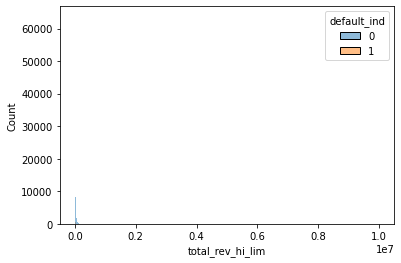

In [160]:
sns.histplot(data=df,x='total_rev_hi_lim',hue='default_ind')

<AxesSubplot:xlabel='out_prncp', ylabel='Count'>

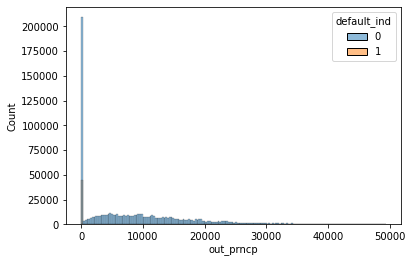

In [159]:
sns.histplot(data=df,x='out_prncp',hue='default_ind')

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='out_prncp', ylabel='Density'>

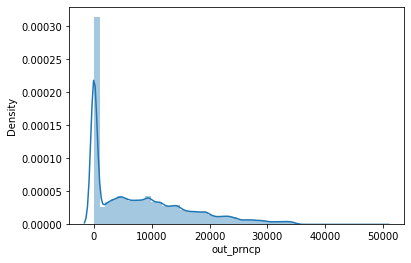

In [146]:
sns.distplot(df['out_prncp'])

C:\Users\mmoy\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\xgboost\data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[[11500    12]
 [   54 11668]]
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     11512
           1       1.00      1.00      1.00     11722

    accuracy                           1.00     23234
   macro avg       1.00      1.00      1.00     23234
weighted avg       1.00      1.00      1.00     23234



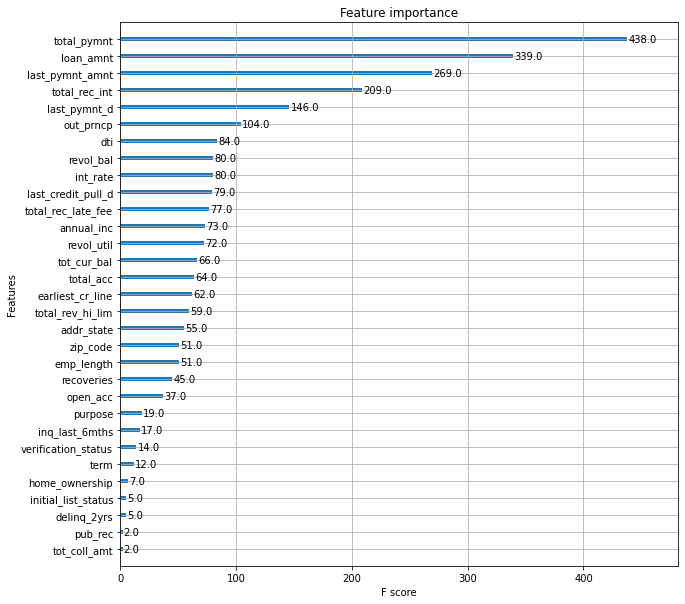

In [128]:
#Random splitting
X=df.drop(['default_ind','issue_d'],axis=1)
#X=df[['issue_d']]
y=df['default_ind']


undersample = RandomUnderSampler(sampling_strategy='majority')
X,y = undersample.fit_resample(X, y)

X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.75, test_size=0.25)

model_class = xgb.XGBClassifier(use_label_encoder=False,eval_metric='logloss')
model_class.fit(X_train,np.ravel(y_train))


fig, ax = plt.subplots(figsize=(10,10))
xgb.plot_importance(model_class,importance_type='weight', ax=ax)

y_class_pred = model_class.predict(X_test)
print(confusion_matrix(y_test, y_class_pred))
print(classification_report(y_test, y_class_pred))


(array([46156.,     0.,     0.,     0.,     0.,     0.,     0.,     0.,
            0., 46156.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

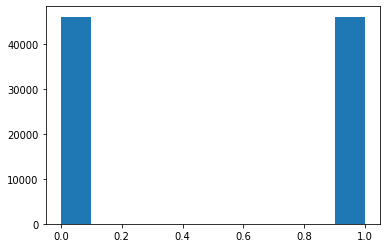

In [112]:
plt.hist(y_train)

C:\Users\mmoy\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.9_qbz5n2kfra8p0\LocalCache\local-packages\Python39\site-packages\xgboost\data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[[311   0]
 [ 10 301]]
              precision    recall  f1-score   support

           0       0.97      1.00      0.98       311
           1       1.00      0.97      0.98       311

    accuracy                           0.98       622
   macro avg       0.98      0.98      0.98       622
weighted avg       0.98      0.98      0.98       622



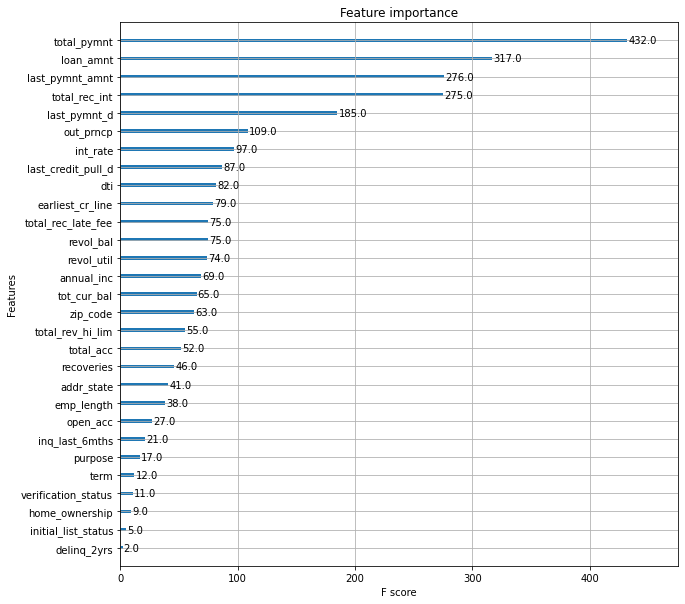

In [129]:
#Splitting on Date
X=df.drop('default_ind',axis=1)
#X=df[['out_prncp','last_pymnt_d','int_rate','recoveries','issue_d']]
y=df[['default_ind','issue_d']]

X_train=X[X['issue_d']<=20150501].drop('issue_d',axis=1)
X_test=X[X['issue_d']>20150501].drop('issue_d',axis=1)

y_train=y[y['issue_d']<=20150501]['default_ind']
y_test=y[y['issue_d']>20150501]['default_ind']

undersample = RandomUnderSampler(sampling_strategy='majority')
X_train,y_train = undersample.fit_resample(X_train, y_train)
X_test,y_test = undersample.fit_resample(X_test, y_test)

model_class = xgb.XGBClassifier(use_label_encoder=False,eval_metric='logloss')
model_class.fit(X_train,np.ravel(y_train))


fig, ax = plt.subplots(figsize=(10,10))
xgb.plot_importance(model_class,importance_type='weight', ax=ax)

y_class_pred = model_class.predict(X_test)
print(confusion_matrix(y_test, y_class_pred))
print(classification_report(y_test, y_class_pred))


(array([552822.,      0.,      0.,      0.,      0.,      0.,      0.,
             0.,      0.,  46156.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

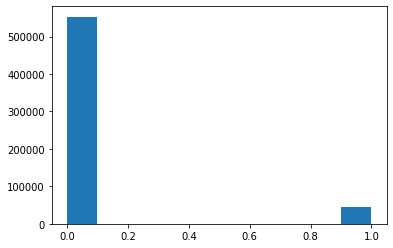

In [28]:
plt.hist(y_train)

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='grade', ylabel='Density'>

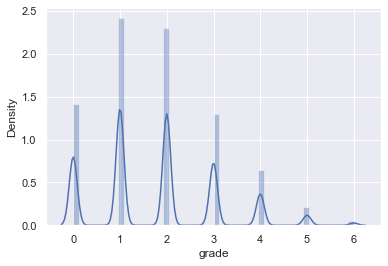

In [317]:
sns.distplot(df['grade'])

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='sub_grade', ylabel='Density'>

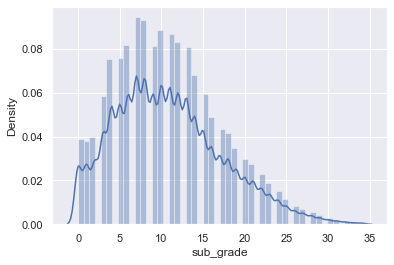

In [318]:
sns.distplot(df['sub_grade'])

Useful

In [315]:
#Core - Read CSV file
df=pd.read_csv('xyz_corp_lending_data.csv',sep='\t')

FileNotFoundError: [Errno 2] No such file or directory: 'xyz_corp_lending_data.csv'

In [13]:
df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'pymnt_plan', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record',
       'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'verification_status_joint', 'acc_now_delinq', 'tot_col

In [34]:
#Core - Drop columns (to be explained why for each column)
df=df.drop(['policy_code','funded_amnt','funded_amnt_inv','out_prncp_inv','total_pymnt_inv','id','member_id','total_rec_prncp','policy_code','installment','pymnt_plan','application_type','next_pymnt_d','title','emp_title','grade'],axis=1)

In [29]:
#Core - Creating a metric to get % of null values and selecting the columns that have less than 50%
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
df=df[nullity[nullity<50].index]

In [30]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

next_pymnt_d                  29.553757
tot_cur_bal                    7.863953
tot_coll_amt                   7.863953
total_rev_hi_lim               7.863953
emp_title                      5.776261
emp_length                     5.030673
last_pymnt_d                   1.035318
revol_util                     0.052105
collections_12_mths_ex_med     0.006542
last_credit_pull_d             0.005841
title                          0.003855
issue_d                        0.000000
pymnt_plan                     0.000000
purpose                        0.000000
inq_last_6mths                 0.000000
zip_code                       0.000000
addr_state                     0.000000
dti                            0.000000
delinq_2yrs                    0.000000
earliest_cr_line               0.000000
initial_list_status            0.000000
open_acc                       0.000000
pub_rec                        0.000000
revol_bal                      0.000000
total_acc                      0.000000


In [36]:
#Core - Removing text from emp_length and term columns and converting to float
df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('float')

C:\Users\mmoy\AppData\Local\Temp\ipykernel_9928\2533272845.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '').astype('float')
C:\Users\mmoy\AppData\Local\Temp\ipykernel_9928\2533272845.py:3: FutureWarning: The default value of regex will change from True to False in a future version.
  df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('float')


In [ ]:
#Core - Converting Date Columns to YYYYMMDD format and float
date_cols=['last_pymnt_d','last_credit_pull_d','issue_d','earliest_cr_line']
for col in date_cols:
    df[col]=pd.to_datetime(df[col]).dt.strftime('%Y%m%d').astype(float)

In [103]:
#Filling na with median or mode
med=['tot_cur_bal','tot_coll_amt','total_rev_hi_lim','revol_util']
mod=['emp_length','last_pymnt_d','collections_12_mths_ex_med','last_credit_pull_d']
for col in med:
    df[col]=df[col].fillna(df[col].median())

for col in mod:
    df[col]=df[col].fillna(df[col].mode()[0])

In [114]:
#Cleaning up zip_code to only have numbers and concatenating with addr_state
#Maybe drop the addr_code as it is fully represented by the zip code
df['zip_code']=df['zip_code'].str.replace('[A-Za-z\s+<>]+', '').astype(float)

#df['address']=df['zip_code']+df['addr_state']


In [121]:
df['addr_state'].value_counts()

CA    125172
NY     71114
TX     68708
FL     58639
IL     34379
NJ     32061
PA     30250
OH     28651
GA     28043
VA     25234
NC     23787
MI     22175
MD     20209
MA     19835
AZ     19693
WA     18816
CO     18211
MN     15424
MO     13743
IN     13348
CT     13042
TN     12392
NV     11972
WI     11199
AL     10732
OR     10562
SC     10302
LA     10186
KY      8299
OK      7759
KS      7693
AR      6399
UT      6055
NM      4757
HI      4380
WV      4247
NH      4156
RI      3753
MS      3653
MT      2466
DE      2402
DC      2382
AK      2134
WY      1974
VT      1753
SD      1745
NE      1124
ME       491
ND       452
ID         9
IA         7
Name: addr_state, dtype: int64

In [119]:
df['zip_code'].value_counts()

945    9466
750    9111
112    8894
606    8370
300    7820
       ... 
503       1
889       1
524       1
888       1
507       1
Name: zip_code, Length: 931, dtype: int64

In [115]:
df['address'].value_counts()

945CA    9461
750TX    9103
112NY    8885
606IL    8366
300GA    7813
         ... 
770AZ       1
774CT       1
222DC       1
229NC       1
160MA       1
Name: address, Length: 1943, dtype: int64

# Useful

In [44]:
df.index

RangeIndex(start=0, stop=855969, step=1)

In [100]:
df.columns

Index(['tot_cur_bal', 'total_rev_hi_lim', 'tot_coll_amt', 'emp_length',
       'last_pymnt_d', 'revol_util', 'collections_12_mths_ex_med',
       'last_credit_pull_d', 'acc_now_delinq', 'last_pymnt_amnt', 'loan_amnt',
       'recoveries', 'collection_recovery_fee', 'delinq_2yrs', 'int_rate',
       'sub_grade', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'purpose', 'zip_code', 'addr_state', 'dti',
       'earliest_cr_line', 'term', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'total_acc', 'initial_list_status', 'out_prncp',
       'total_pymnt', 'total_rec_int', 'total_rec_late_fee', 'default_ind'],
      dtype='object')

In [109]:
df.head()

,tot_cur_bal,total_rev_hi_lim,tot_coll_amt,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,acc_now_delinq,last_pymnt_amnt,loan_amnt,recoveries,collection_recovery_fee,delinq_2yrs,int_rate,sub_grade,home_ownership,annual_inc,verification_status,issue_d,purpose,zip_code,addr_state,dti,earliest_cr_line,term,inq_last_6mths,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,default_ind
0,81008.5,23800.0,0.0,10.0,20150101.0,83.7,0.0,20160101.0,0.0,171.62,5000.0,0.00,0.00,0.0,10.65,B2,RENT,24000.0,Verified,20111201.0,credit_card,860.0,AZ,27.65,19850101.0,36.0,1.0,3.0,0.0,13648.0,9.0,f,0.0,5861.071414,861.07,0.00,0
1,81008.5,23800.0,0.0,1.0,20130401.0,9.4,0.0,20130901.0,0.0,119.66,2500.0,117.08,1.11,0.0,15.27,C4,RENT,30000.0,Source Verified,20111201.0,car,309.0,GA,1.00,19990401.0,60.0,5.0,3.0,0.0,1687.0,4.0,f,0.0,1008.710000,435.17,0.00,1
2,81008.5,23800.0,0.0,10.0,20140601.0,98.5,0.0,20160101.0,0.0,649.91,2400.0,0.00,0.00,0.0,15.96,C5,RENT,12252.0,Not Verified,20111201.0,small_business,606.0,IL,8.72,20011101.0,36.0,2.0,2.0,0.0,2956.0,10.0,f,0.0,3003.653644,603.65,0.00,0
3,81008.5,23800.0,0.0,10.0,20150101.0,21.0,0.0,20150101.0,0.0,357.48,10000.0,0.00,0.00,0.0,13.49,C1,RENT,49200.0,Source Verified,20111201.0,other,917.0,CA,20.00,19960201.0,36.0,1.0,10.0,0.0,5598.0,37.0,f,0.0,12226.302212,2209.33,16.97,0
4,81008.5,23800.0,0.0,1.0,20160101.0,53.9,0.0,20160101.0,0.0,67.79,3000.0,0.00,0.00,0.0,12.69,B5,RENT,80000.0,Source Verified,20111201.0,other,972.0,OR,17.94,19960101.0,60.0,0.0,15.0,0.0,27783.0,38.0,f,766.9,3242.170000,1009.07,0.00,0


In [47]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 37 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   tot_cur_bal                 788656 non-null  float64
 1   total_rev_hi_lim            788656 non-null  float64
 2   tot_coll_amt                788656 non-null  float64
 3   emp_length                  812908 non-null  float64
 4   last_pymnt_d                847107 non-null  float64
 5   revol_util                  855523 non-null  float64
 6   collections_12_mths_ex_med  855913 non-null  float64
 7   last_credit_pull_d          855919 non-null  float64
 8   acc_now_delinq              855969 non-null  float64
 9   last_pymnt_amnt             855969 non-null  float64
 10  loan_amnt                   855969 non-null  float64
 11  recoveries                  855969 non-null  float64
 12  collection_recovery_fee     855969 non-null  float64
 13  delinq_2yrs   

In [172]:
df['dti'].value_counts()

19.20    656
14.40    653
18.00    638
16.80    610
13.20    604
        ... 
57.14      1
43.78      1
44.86      1
43.68      1
59.19      1
Name: dti, Length: 4074, dtype: int64

<AxesSubplot:xlabel='dti', ylabel='Count'>

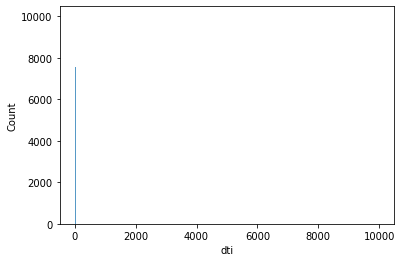

In [171]:
sns.histplot(df['dti'])

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='recoveries', ylabel='Density'>

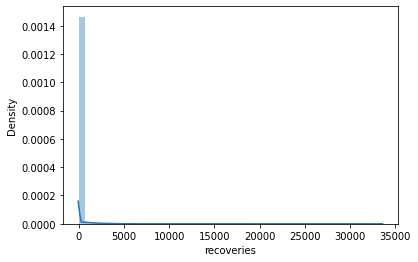

In [169]:
sns.distplot(df['recoveries'])

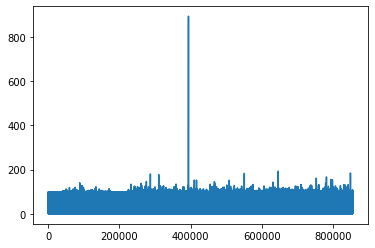

In [178]:
plt.plot(df['revol_util'])

<AxesSubplot:xlabel='annual_inc', ylabel='dti'>

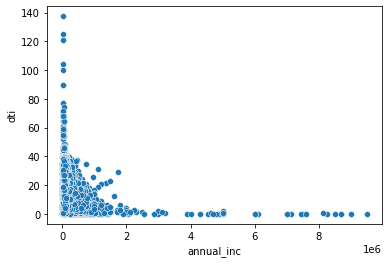

In [199]:
sns.scatterplot(data=df,x='annual_inc',y='dti')

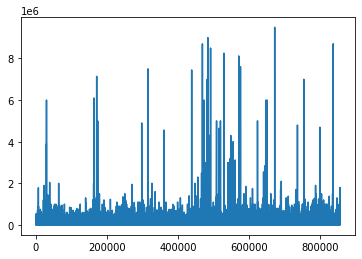

In [191]:
plt.plot(df['annual_inc'])

In [204]:
df.iloc[794721]

total_rev_hi_lim                 15000.00
tot_cur_bal                      25157.00
tot_coll_amt                         0.00
emp_length                           4.00
last_pymnt_d                  20160101.00
revol_util                          73.00
collections_12_mths_ex_med           0.00
last_credit_pull_d            20160101.00
acc_now_delinq                       0.00
loan_amnt                        10000.00
recoveries                           0.00
last_pymnt_amnt                    312.86
earliest_cr_line              20041201.00
int_rate                             7.89
home_ownership                       5.00
annual_inc                       52000.00
verification_status                  1.00
issue_d                       20150301.00
purpose                              2.00
zip_code                           191.00
addr_state                          38.00
dti                                 14.35
delinq_2yrs                          0.00
inq_last_6mths                    

In [203]:
df[df['acc_now_delinq']>6]['acc_now_delinq']

794721    14.0
Name: acc_now_delinq, dtype: float64

In [208]:
df['total_rec_late_fee'].value_counts()

0.000000      845990
15.000000       2248
30.000000        249
45.000000         28
16.370000         15
               ...  
119.878520         1
14.955329          1
29.245338          1
14.966255          1
32.230000          1
Name: total_rec_late_fee, Length: 5386, dtype: int64

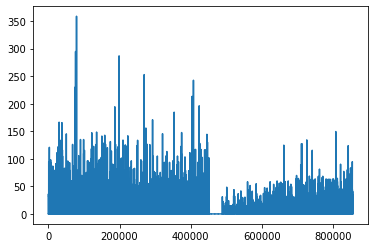

In [206]:
plt.plot(df['total_rec_late_fee'])

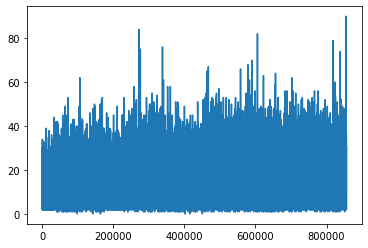

In [205]:
plt.plot(df['open_acc'])

In [190]:
df[df['annual_inc']==0]['annual_inc']

462577    0.0
508976    0.0
Name: annual_inc, dtype: float64

In [177]:
df.iloc[462577]

total_rev_hi_lim                  8100.00
tot_cur_bal                       8715.00
tot_coll_amt                         0.00
emp_length                          10.00
last_pymnt_d                  20160101.00
revol_util                          88.40
collections_12_mths_ex_med           0.00
last_credit_pull_d            20160101.00
acc_now_delinq                       0.00
loan_amnt                        20000.00
recoveries                           0.00
last_pymnt_amnt                    712.96
earliest_cr_line              20010701.00
int_rate                            16.99
home_ownership                       1.00
annual_inc                           0.00
verification_status                  0.00
issue_d                       20151201.00
purpose                              2.00
zip_code                           760.00
addr_state                          43.00
dti                               9999.00
delinq_2yrs                          0.00
inq_last_6mths                    

In [200]:
df[df['revol_util']>200]['revol_util']

394246    892.3
Name: revol_util, dtype: float64

In [196]:
df[df['dti']>80]['dti']

455963    137.40
457061     89.83
466829    100.09
471619     90.00
498969    120.66
521134    125.25
540528    104.00
Name: dti, dtype: float64

In [215]:
df['total_pymnt'].value_counts()

0.000000        8959
938.060000       134
648.570000       133
623.860000       131
1566.460000      117
                ... 
9282.757750        1
31064.771763       1
19427.566200       1
11161.979915       1
4863.330000        1
Name: total_pymnt, Length: 494606, dtype: int64

In [221]:
df.iloc[452702]

total_rev_hi_lim                 28600.00
tot_cur_bal                     492729.00
tot_coll_amt                         0.00
emp_length                           3.00
last_pymnt_d                  20160101.00
revol_util                          83.90
collections_12_mths_ex_med           1.00
last_credit_pull_d            20160101.00
acc_now_delinq                       0.00
loan_amnt                        35000.00
recoveries                           0.00
last_pymnt_amnt                      0.00
earliest_cr_line              20010801.00
int_rate                            11.99
home_ownership                       1.00
annual_inc                      150000.00
verification_status                  1.00
issue_d                       20151201.00
purpose                              1.00
zip_code                           328.00
addr_state                           9.00
dti                                 13.60
delinq_2yrs                          0.00
inq_last_6mths                    

In [237]:
df[df['out_prncp']>35000]['out_prncp']

495642    49372.86
499639    47406.94
564361    40374.86
Name: out_prncp, dtype: float64

In [223]:
df[(df['out_prncp']>34000)&(df['default_ind']==1)]['out_prncp']

615201    35000.00
668230    34423.47
723629    34073.89
723957    34033.94
Name: out_prncp, dtype: float64

In [240]:
df['initial_list_status'].value_counts()

0    442553
1    413411
Name: initial_list_status, dtype: int64

<AxesSubplot:xlabel='initial_list_status', ylabel='Count'>

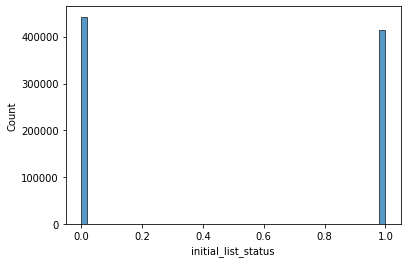

In [241]:
sns.histplot(data=df,x='initial_list_status')

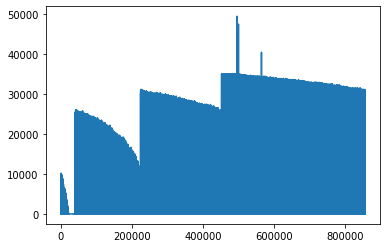

In [233]:
plt.plot(df[df['default_ind']==0]['out_prncp'])

In [281]:
df[df['total_rev_hi_lim']>2000000]['total_rev_hi_lim']

125028    9999999.0
172322    2013133.0
292614    9999999.0
728685    9999999.0
Name: total_rev_hi_lim, dtype: float64

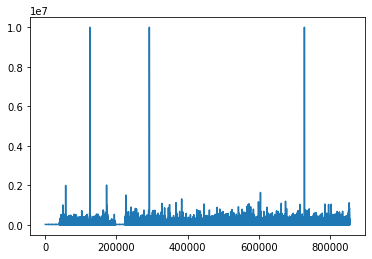

In [279]:
plt.plot(df['total_rev_hi_lim'])

In [302]:
df[df['default_ind']==1]['int_rate'].value_counts()

16.29    1303
15.61    1200
15.31    1021
12.99     991
12.12     981
         ... 
18.72       1
15.25       1
13.04       1
15.38       1
5.93        1
Name: int_rate, Length: 469, dtype: int64

<AxesSubplot:xlabel='emp_length', ylabel='Count'>

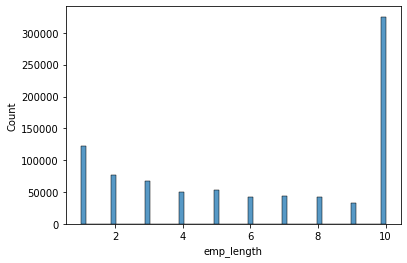

In [268]:
sns.histplot(data=df,x='emp_length')

In [290]:
df.describe()

,total_rev_hi_lim,tot_cur_bal,tot_coll_amt,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,acc_now_delinq,loan_amnt,recoveries,last_pymnt_amnt,earliest_cr_line,int_rate,home_ownership,annual_inc,verification_status,issue_d,purpose,zip_code,addr_state,dti,delinq_2yrs,inq_last_6mths,collection_recovery_fee,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,term,default_ind
count,8.559500e+05,8.559500e+05,855950.000000,855950.000000,8.559500e+05,855950.000000,855950.000000,8.559500e+05,855950.000000,855950.000000,855950.000000,855950.000000,8.559500e+05,855950.000000,855950.000000,8.559500e+05,855950.000000,8.559500e+05,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,8.559500e+05,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000,855950.000000
mean,3.146545e+04,1.351041e+05,196.998279,6.298544,2.015381e+07,55.018981,0.014213,2.015741e+07,0.004927,14745.416788,47.090545,2225.959636,1.997744e+07,13.192315,2.895974,7.505976e+04,1.026048,2.014094e+07,2.562305,511.969586,23.135376,18.096433,0.311602,0.680904,4.951337,11.542434,0.194539,1.689602e+04,25.269150,0.482979,8284.657201,7653.217484,1755.043154,0.319537,43.170867,0.054287
std,3.094510e+04,1.479293e+05,1875.961297,3.548812,9.466169e+03,23.788040,0.132851,7.093713e+03,0.075833,8425.205865,413.140569,4864.863406,7.432255e+04,4.368368,1.921845,6.400514e+04,0.792212,1.237156e+04,2.271323,313.089565,15.156347,8.295713,0.857061,0.964021,62.479258,5.308054,0.581590,2.147964e+04,11.818674,0.499710,8461.620894,7909.161238,2081.686921,3.609439,10.985428,0.226583
min,0.000000e+00,0.000000e+00,0.000000,1.000000,2.008010e+07,0.000000,0.000000,2.007050e+07,0.000000,500.000000,0.000000,0.000000,1.944010e+07,5.320000,0.000000,3.000000e+03,0.000000,2.007060e+07,0.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,36.000000,0.000000
25%,1.475000e+04,3.225025e+04,0.000000,3.000000,2.015100e+07,37.600000,0.000000,2.016010e+07,0.000000,8000.000000,0.000000,285.420000,1.994060e+07,9.990000,1.000000,4.500000e+04,0.000000,2.013120e+07,2.000000,228.000000,9.000000,11.880000,0.000000,0.000000,0.000000,8.000000,0.000000,6.469000e+03,17.000000,0.000000,0.000000,1969.712500,451.270000,0.000000,36.000000,0.000000
50%,2.380000e+04,8.100850e+04,0.000000,7.000000,2.016010e+07,55.900000,0.000000,2.016010e+07,0.000000,13000.000000,0.000000,468.820000,1.999080e+07,12.990000,1.000000,6.500000e+04,1.000000,2.014110e+07,2.000000,478.000000,23.000000,17.610000,0.000000,0.000000,0.000000,11.000000,0.000000,1.190300e+04,24.000000,0.000000,6290.120000,4976.175000,1076.910000,0.000000,36.000000,0.000000
75%,3.800000e+04,1.963710e+05,0.000000,10.000000,2.016010e+07,73.500000,0.000000,2.016010e+07,0.000000,20000.000000,0.000000,849.157500,2.003040e+07,15.990000,5.000000,9.000000e+04,2.000000,2.015070e+07,2.000000,802.000000,36.000000,23.900000,0.000000,1.000000,0.000000,14.000000,0.000000,2.085700e+04,32.000000,1.000000,13527.952500,10744.690000,2233.970000,0.000000,60.000000,0.000000
max,1.998700e+06,3.726495e+06,496651.000000,10.000000,2.016010e+07,193.000000,20.000000,2.016010e+07,6.000000,35000.000000,33520.270000,36475.590000,2.012110e+07,28.990000,5.000000,9.500000e+06,2.000000,2.015120e+07,13.000000,999.000000,50.000000,137.400000,39.000000,8.000000,7002.190000,90.000000,86.000000,1.746716e+06,169.000000,1.000000,35000.000000,57777.579870,24205.620000,358.680000,60.000000,1.000000


In [291]:
df[df['default_ind']==0].describe()

,total_rev_hi_lim,tot_cur_bal,tot_coll_amt,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,acc_now_delinq,loan_amnt,recoveries,last_pymnt_amnt,earliest_cr_line,int_rate,home_ownership,annual_inc,verification_status,issue_d,purpose,zip_code,addr_state,dti,delinq_2yrs,inq_last_6mths,collection_recovery_fee,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,term,default_ind
count,8.094830e+05,8.094830e+05,809483.000000,809483.000000,8.094830e+05,809483.000000,809483.000000,8.094830e+05,809483.000000,809483.000000,809483.0,809483.000000,8.094830e+05,809483.000000,809483.000000,8.094830e+05,809483.000000,8.094830e+05,809483.000000,809483.000000,809483.000000,809483.000000,809483.000000,809483.000000,809483.0,809483.000000,809483.000000,8.094830e+05,809483.000000,809483.000000,809483.000000,809483.000000,809483.000000,809483.000000,809483.000000,809483.0
mean,3.178827e+04,1.367089e+05,202.281980,6.308685,2.015453e+07,54.765237,0.014554,2.015779e+07,0.004983,14755.313021,0.0,2327.618674,1.997723e+07,13.030048,2.881083,7.562983e+04,1.018534,2.014155e+07,2.538592,511.927128,23.165412,18.076468,0.313488,0.663717,0.0,11.570028,0.197272,1.700538e+04,25.328856,0.494810,8742.763019,7727.535578,1732.075109,0.197810,43.088287,0.0
std,3.132898e+04,1.494874e+05,1909.039368,3.550616,8.804858e+03,23.781416,0.134646,6.576610e+03,0.076116,8427.010234,0.0,4981.047342,7.452809e+04,4.316367,1.920593,6.434454e+04,0.790026,1.205265e+04,2.240170,312.839415,15.158155,8.314653,0.860216,0.950909,0.0,5.327381,0.588154,2.168497e+04,11.832124,0.499973,8459.346838,8022.155027,2069.671339,2.772259,10.948755,0.0
min,0.000000e+00,0.000000e+00,0.000000,1.000000,2.008010e+07,0.000000,0.000000,2.007050e+07,0.000000,500.000000,0.0,0.000000,1.944010e+07,5.320000,0.000000,3.000000e+03,0.000000,2.007060e+07,0.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000e+00,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,36.000000,0.0
25%,1.480000e+04,3.226100e+04,0.000000,3.000000,2.015120e+07,37.400000,0.000000,2.016010e+07,0.000000,8000.000000,0.0,289.020000,1.994060e+07,9.760000,1.000000,4.600000e+04,0.000000,2.014010e+07,2.000000,229.000000,9.000000,11.840000,0.000000,0.000000,0.0,8.000000,0.000000,6.481000e+03,17.000000,0.000000,0.000000,1935.470000,439.960000,0.000000,36.000000,0.0
50%,2.380000e+04,8.100850e+04,0.000000,7.000000,2.016010e+07,55.600000,0.000000,2.016010e+07,0.000000,13000.000000,0.0,473.420000,1.999080e+07,12.690000,1.000000,6.500000e+04,1.000000,2.014120e+07,2.000000,479.000000,23.000000,17.570000,0.000000,0.000000,0.0,11.000000,0.000000,1.193900e+04,24.000000,0.000000,7000.000000,4987.630000,1056.460000,0.000000,36.000000,0.0
75%,3.850000e+04,1.994805e+05,0.000000,10.000000,2.016010e+07,73.200000,0.000000,2.016010e+07,0.000000,20000.000000,0.0,876.130000,2.003050e+07,15.610000,5.000000,9.000000e+04,2.000000,2.015070e+07,2.000000,802.000000,36.000000,23.880000,0.000000,1.000000,0.0,14.000000,0.000000,2.096400e+04,32.000000,1.000000,13966.690000,10897.168653,2202.265000,0.000000,60.000000,0.0
max,1.508600e+06,3.726495e+06,496651.000000,10.000000,2.016010e+07,193.000000,20.000000,2.016010e+07,6.000000,35000.000000,0.0,36475.590000,2.012110e+07,28.990000,5.000000,9.500000e+06,2.000000,2.015120e+07,13.000000,999.000000,50.000000,137.400000,39.000000,8.000000,0.0,90.000000,86.000000,1.298783e+06,169.000000,1.000000,35000.000000,57777.579870,24205.620000,286.747566,60.000000,0.0


In [292]:
df[df['default_ind']==1].describe()

,total_rev_hi_lim,tot_cur_bal,tot_coll_amt,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,acc_now_delinq,loan_amnt,recoveries,last_pymnt_amnt,earliest_cr_line,int_rate,home_ownership,annual_inc,verification_status,issue_d,purpose,zip_code,addr_state,dti,delinq_2yrs,inq_last_6mths,collection_recovery_fee,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,total_rec_late_fee,term,default_ind
count,4.646700e+04,4.646700e+04,46467.000000,46467.000000,4.646700e+04,46467.000000,46467.000000,4.646700e+04,46467.000000,46467.000000,46467.000000,46467.000000,4.646700e+04,46467.000000,46467.000000,4.646700e+04,46467.000000,4.646700e+04,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,4.646700e+04,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.000000,46467.0
mean,2.584162e+04,1.071477e+05,104.953042,6.121893,2.014132e+07,59.439342,0.008285,2.015084e+07,0.003938,14573.018486,867.436067,454.998240,1.998112e+07,16.019092,3.155379,6.512892e+04,1.156950,2.013023e+07,2.975402,512.709235,22.612133,18.444234,0.278757,0.980309,91.206597,11.061721,0.146943,1.499084e+04,24.229044,0.276885,304.179196,6358.551737,2155.160268,2.440093,44.609465,1.0
std,2.253252e+04,1.139474e+05,1152.924656,3.512568,1.162533e+04,23.467230,0.096177,1.130573e+04,0.070703,8391.928489,1559.671060,650.022043,7.054553e+04,4.301283,1.925149,5.686452e+04,0.818379,1.294125e+04,2.725252,317.418193,15.115410,7.950591,0.799408,1.127832,253.065131,4.934646,0.449553,1.741112e+04,11.532493,0.447464,2219.353977,5424.353661,2243.479601,10.067126,11.511174,0.0
min,0.000000e+00,0.000000e+00,0.000000,1.000000,2.008030e+07,0.000000,0.000000,2.009010e+07,0.000000,900.000000,0.000000,0.000000,1.955010e+07,5.420000,1.000000,4.080000e+03,0.000000,2.007080e+07,0.000000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,36.000000,1.0
25%,1.450000e+04,3.207650e+04,0.000000,3.000000,2.014010e+07,43.200000,0.000000,2.014120e+07,0.000000,8000.000000,0.000000,237.850000,1.995040e+07,13.050000,1.000000,4.000000e+04,0.000000,2.012100e+07,2.000000,224.000000,9.000000,12.610000,0.000000,0.000000,0.000000,8.000000,0.000000,6.226500e+03,16.000000,0.000000,0.000000,2496.360000,686.065000,0.000000,36.000000,1.0
50%,2.380000e+04,8.100850e+04,0.000000,6.000000,2.014110e+07,61.500000,0.000000,2.015120e+07,0.000000,12700.000000,16.250000,375.880000,1.999110e+07,15.800000,4.000000,5.600000e+04,1.000000,2.013080e+07,2.000000,463.000000,22.000000,18.380000,0.000000,1.000000,0.000000,10.000000,0.000000,1.134900e+04,23.000000,0.000000,0.000000,4855.880000,1434.080000,0.000000,36.000000,1.0
75%,2.890000e+04,1.378180e+05,0.000000,10.000000,2.015050e+07,78.000000,0.000000,2.016010e+07,0.000000,20000.000000,1214.165000,568.700000,2.003040e+07,18.920000,5.000000,7.800000e+04,2.000000,2.014050e+07,2.000000,850.000000,35.000000,24.140000,0.000000,2.000000,24.915500,14.000000,0.000000,1.921300e+04,31.000000,1.000000,0.000000,8606.465000,2778.530000,0.000000,60.000000,1.0
max,1.998700e+06,3.437283e+06,95806.000000,10.000000,2.016010e+07,129.400000,4.000000,2.016010e+07,5.000000,35000.000000,33520.270000,34833.350000,2.012040e+07,28.990000,5.000000,8.706582e+06,2.000000,2.015090e+07,13.000000,999.000000,50.000000,39.980000,18.000000,8.000000,7002.190000,76.000000,12.000000,1.746716e+06,110.000000,1.000000,35000.000000,46199.440000,20610.170000,358.680000,60.000000,1.0


In [209]:
df.columns

Index(['total_rev_hi_lim', 'tot_cur_bal', 'tot_coll_amt', 'emp_length',
       'last_pymnt_d', 'revol_util', 'collections_12_mths_ex_med',
       'last_credit_pull_d', 'acc_now_delinq', 'loan_amnt', 'recoveries',
       'last_pymnt_amnt', 'earliest_cr_line', 'int_rate', 'home_ownership',
       'annual_inc', 'verification_status', 'issue_d', 'purpose', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'inq_last_6mths',
       'collection_recovery_fee', 'open_acc', 'pub_rec', 'revol_bal',
       'total_acc', 'initial_list_status', 'out_prncp', 'total_pymnt',
       'total_rec_int', 'total_rec_late_fee', 'term', 'default_ind'],
      dtype='object')

In [49]:
df.shape

(855969, 37)

In [50]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

tot_cur_bal                   7.863953
tot_coll_amt                  7.863953
total_rev_hi_lim              7.863953
emp_length                    5.030673
last_pymnt_d                  1.035318
revol_util                    0.052105
collections_12_mths_ex_med    0.006542
last_credit_pull_d            0.005841
revol_bal                     0.000000
earliest_cr_line              0.000000
term                          0.000000
inq_last_6mths                0.000000
open_acc                      0.000000
pub_rec                       0.000000
out_prncp                     0.000000
total_acc                     0.000000
initial_list_status           0.000000
addr_state                    0.000000
total_pymnt                   0.000000
total_rec_int                 0.000000
total_rec_late_fee            0.000000
dti                           0.000000
verification_status           0.000000
zip_code                      0.000000
purpose                       0.000000
issue_d                  

# History

In [51]:
#Core
df=pd.read_csv('xyz_corp_lending_data.csv',sep='\t')

C:\Users\mmoy\AppData\Local\Temp\ipykernel_9928\4080014032.py:2: DtypeWarning: Columns (17,45,53) have mixed types. Specify dtype option on import or set low_memory=False.
  df=pd.read_csv('xyz_corp_lending_data.csv',sep='\t')


In [52]:
df.index

RangeIndex(start=0, stop=855969, step=1)

In [53]:
df.columns

Index(['id', 'member_id', 'loan_amnt', 'funded_amnt', 'funded_amnt_inv',
       'term', 'int_rate', 'installment', 'grade', 'sub_grade', 'emp_title',
       'emp_length', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'pymnt_plan', 'desc', 'purpose', 'title', 'zip_code',
       'addr_state', 'dti', 'delinq_2yrs', 'earliest_cr_line',
       'inq_last_6mths', 'mths_since_last_delinq', 'mths_since_last_record',
       'open_acc', 'pub_rec', 'revol_bal', 'revol_util', 'total_acc',
       'initial_list_status', 'out_prncp', 'out_prncp_inv', 'total_pymnt',
       'total_pymnt_inv', 'total_rec_prncp', 'total_rec_int',
       'total_rec_late_fee', 'recoveries', 'collection_recovery_fee',
       'last_pymnt_d', 'last_pymnt_amnt', 'next_pymnt_d', 'last_credit_pull_d',
       'collections_12_mths_ex_med', 'mths_since_last_major_derog',
       'policy_code', 'application_type', 'annual_inc_joint', 'dti_joint',
       'verification_status_joint', 'acc_now_delinq', 'tot_col

In [54]:
df.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,pymnt_plan,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
0,1077501,1296599,5000.0,5000.0,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-2011,n,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-1985,1.0,NaN,NaN,3.0,0.0,13648.0,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-2015,171.62,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,1077430,1314167,2500.0,2500.0,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-2011,n,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-1999,5.0,NaN,NaN,3.0,0.0,1687.0,9.4,4.0,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-2013,119.66,NaN,Sep-2013,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1
2,1077175,1313524,2400.0,2400.0,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-2011,n,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-2001,2.0,NaN,NaN,2.0,0.0,2956.0,98.5,10.0,f,0.0,0.0,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-2014,649.91,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
3,1076863,1277178,10000.0,10000.0,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-2011,n,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-1996,1.0,35.0,NaN,10.0,0.0,5598.0,21.0,37.0,f,0.0,0.0,12226.302212,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-2015,357.48,NaN,Jan-2015,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,1075358,1311748,3000.0,3000.0,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-2011,n,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-1996,0.0,38.0,NaN,15.0,0.0,27783.0,53.9,38.0,f,766.9,766.9,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-2016,67.79,Feb-2016,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [55]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 73 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           855969 non-null  int64  
 1   member_id                    855969 non-null  int64  
 2   loan_amnt                    855969 non-null  float64
 3   funded_amnt                  855969 non-null  float64
 4   funded_amnt_inv              855969 non-null  float64
 5   term                         855969 non-null  object 
 6   int_rate                     855969 non-null  float64
 7   installment                  855969 non-null  float64
 8   grade                        855969 non-null  object 
 9   sub_grade                    855969 non-null  object 
 10  emp_title                    806526 non-null  object 
 11  emp_length                   812908 non-null  object 
 12  home_ownership               855969 non-null  object 
 13 

In [56]:
df.describe()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,int_rate,installment,annual_inc,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,default_ind
count,8.559690e+05,8.559690e+05,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,8.559690e+05,855969.000000,855969.000000,855969.000000,416157.000000,131184.000000,855969.000000,855969.000000,8.559690e+05,855523.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.00000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855969.000000,855913.000000,213139.000000,855969.0,442.000000,440.000000,855969.000000,7.886560e+05,7.886560e+05,13288.000000,13288.000000,13288.000000,13288.000000,12934.000000,13288.000000,11609.000000,13288.000000,13288.000000,13288.000000,13288.000000,7.886560e+05,13288.000000,13288.000000,13288.000000,855969.000000
mean,3.224073e+07,3.476269e+07,14745.571335,14732.378305,14700.061226,13.192320,436.238072,7.507119e+04,18.122165,0.311621,0.680915,34.149943,70.463959,11.542447,0.194537,1.691053e+04,55.019405,25.269269,8284.830230,8281.449347,7653.296336,7622.22052,5850.841088,1755.046221,0.319530,47.089499,4.951227,2225.985295,0.014230,44.101450,1.0,107412.163982,18.318477,0.004944,2.254129e+02,1.397662e+05,1.072998,2.945665,0.749323,1.666767,20.833153,36511.541391,71.486993,1.354305,2.945515,5840.443332,61.024526,3.216357e+04,0.947772,1.524232,1.841963,0.054286
std,2.271969e+07,2.399418e+07,8425.340005,8419.471653,8425.805478,4.368365,243.726876,6.426447e+04,17.423629,0.857189,0.964033,21.868500,27.827120,5.308094,0.581585,2.222374e+04,23.811585,11.818841,8461.946669,8458.496422,7909.383591,7885.15640,6676.410888,2081.692980,3.609399,413.136043,62.478569,4864.966593,0.133712,22.164907,0.0,47987.608637,7.221855,0.077333,1.048945e+04,1.539385e+05,1.206939,3.080330,0.986169,1.685394,26.739237,42492.757796,23.015293,1.483710,2.595313,5108.500262,20.018117,3.769964e+04,1.441667,2.697601,2.975049,0.226581
min,5.473400e+04,7.069900e+04,500.000000,500.000000,0.000000,5.320000,15.690000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,2.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,17950.000000,3.050000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-4.000000,0.000000
25%,9.067986e+06,1.079273e+07,8000.000000,8000.000000,8000.000000,9.990000,260.550000,4.500000e+04,11.880000,0.000000,0.000000,15.000000,51.000000,8.000000,0.000000,6.469000e+03,37.600000,17.000000,0.000000,0.000000,1969.690000,1960.12000,1239.950000,451.270000,0.000000,0.000000,0.000000,285.420000,0.000000,27.000000,1.0,75000.250000,13.187500,0.000000,0.000000e+00,2.987000e+04,0.000000,1.000000,0.000000,0.000000,6.000000,10390.250000,58.500000,0.000000,1.000000,2405.000000,47.900000,1.400000e+04,0.000000,0.000000,0.000000,0.000000
50%,3.431355e+07,3.697532e+07,13000.000000,13000.000000,13000.000000,12.990000,382.550000,6.500000e+04,17.610000,0.000000,0.000000,31.000000,70.000000,11.000000,0.000000,1.190300e+04,55.900000,24.000000,6290.250000,6287.650000,4976.160000,4948.25000,3286.890000,1076.910000,0.000000,0.000000,0.000000,468.820000,0.000000,44.000000,1.0,100000.000000,17.735000,0.000000,0.000000e+00,8.100850e+04,1.000000,2.000000,0.000000,1.000000,12.000000,24959.500000,75.000000,1.0

In [57]:
df.shape

(855969, 73)

In [58]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)

In [59]:
nullity

dti_joint                    99.948596
annual_inc_joint             99.948363
verification_status_joint    99.948363
il_util                      98.643759
mths_since_rcnt_il           98.488964
                               ...    
out_prncp                     0.000000
out_prncp_inv                 0.000000
member_id                     0.000000
total_pymnt_inv               0.000000
default_ind                   0.000000
Length: 73, dtype: float64

In [60]:
df['policy_code'].value_counts()

1.0    855969
Name: policy_code, dtype: int64

In [61]:
#Core
df=df[nullity[nullity<50].index]

In [62]:
#Core
df=df.drop('policy_code',axis=1)

In [63]:
df.shape

(855969, 51)

In [312]:
correl=df.corr()
correl

,tot_cur_bal,tot_coll_amt,total_rev_hi_lim,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,loan_amnt,acc_now_delinq,last_pymnt_amnt,total_rec_late_fee,collection_recovery_fee,recoveries,int_rate,grade,sub_grade,home_ownership,annual_inc,verification_status,issue_d,purpose,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,total_pymnt,total_rec_int,term,default_ind
tot_cur_bal,1.000000,-0.002095,0.422014,0.080337,0.070064,0.080170,-0.007186,0.051238,0.325504,0.025070,0.094048,0.000313,0.001616,-0.001280,-0.083144,-0.075638,-0.078305,-0.489569,0.406686,0.063988,0.081701,-0.034953,-0.003165,-0.003964,0.001655,0.069436,-0.170284,0.027610,0.246614,-0.067186,0.434936,0.306335,0.064854,0.228531,0.134702,0.111721,0.111222,-0.045279
tot_coll_amt,-0.002095,1.000000,-0.025749,0.009346,0.029356,-0.041041,0.053932,0.024550,-0.016323,0.002472,-0.012291,-0.004375,-0.002764,-0.005193,0.004588,0.009173,0.009636,-0.008418,0.002024,-0.001010,0.043702,0.009384,0.014653,0.001744,-0.011474,0.004689,-0.032110,0.012781,0.007387,0.040611,-0.028665,0.031413,0.015694,0.010226,-0.030908,-0.021777,-0.006947,-0.011756
total_rev_hi_lim,0.422014,-0.025749,1.000000,0.082446,0.069631,-0.126172,-0.017262,0.044606,0.355260,0.011428,0.066383,-0.010291,-0.000660,-0.003361,-0.182829,-0.164498,-0.171145,-0.172869,0.293761,0.057518,0.085468,-0.066372,-0.030888,0.003817,0.090371,-0.042223,-0.242645,0.002907,0.374391,-0.110988,0.825751,0.291979,0.081082,0.267403,0.114449,0.071139,0.076482,-0.043542
emp_length,0.080337,0.009346,0.082446,1.000000,0.060817,0.026663,-0.003554,0.053333,0.081224,0.008361,0.017228,-0.009911,0.002116,0.002132,0.010476,0.008091,0.008077,-0.190366,0.039965,0.095179,0.053310,-0.014070,-0.013163,0.008340,0.050337,0.020823,-0.238985,-0.007274,0.023921,0.041526,0.080273,0.091772,0.023880,0.063932,0.032187,0.054480,0.052997,-0.011926
last_pymnt_d,0.070064,0.029356,0.069631,0.060817,1.000000,0.034552,0.033505,0.691788,0.098242,0.016354,-0.352441,-0.064921,-0.102148,-0.164321,-0.038430,0.004361,0.002180,-0.023696,0.028440,0.020389,0.704512,-0.111320,-0.014052,0.021411,0.134879,0.049137,0.016019,-0.104865,0.089888,0.063618,0.049737,0.037630,0.269649,0.448248,-0.283649,0.002825,0.087998,-0.316121
revol_util,0.080170,-0.041041,-0.126172,0.026663,0.034552,1.000000,-0.035767,0.053466,0.119737,-0.027531,-0.000940,0.019458,0.019893,0.029620,0.271816,0.248411,0.259025,-0.013877,0.037135,0.084882,-0.011406,-0.112777,0.015884,0.006077,0.179819,-0.016264,-0.005579,-0.088361,-0.144933,-0.079092,0.225952,-0.114602,-0.031871,0.074422,0.081019,0.183876,0.085960,0.044521
collections_12_mths_ex_med,-0.007186,0.053932,-0.017262,-0.003554,0.033505,-0.035767,1.000000,0.027568,-0.017030,0.018562,-0.017834,-0.003850,-0.002875,-0.004700,0.012786,0.019519,0.019876,0.006075,-0.003821,0.011335,0.051311,0.002033,-0.002338,0.006333,0.000351,0.061472,-0.002507,0.006989,0.010240,0.020840,-0.023320,0.009164,0.016966,0.015804,-0.038787,-0.024779,-0.005418,-0.010691
last_credit_pull_d,0.051238,0.024550,0.044606,0.053333,0.691788,0.053466,0.027568,1.000000,0.070239,0.012448,-0.301122,-0.061819,-0.085683,-0.176771,-0.020947,0.008947,0.007727,-0.014607,0.022968,0.015471,0.563542,-0.112232,-0.018000,0.018413,0.123144,0.042686,0.008621,-0.074405,0.085509,0.059519,0.039513,0.052401,0.217199,0.363883,-0.251913,-0.001667,0.060051,-0.221918
loan_amnt,0.325504,-0.016323,0.355260,0.081224,0.098242,0.119737,-0.017030,0.070239,1.000000,0.003803,0.233586,0.025968,0.055138,0.075517,0.142977,0.150879,0.156745,-0.196497,0.336175,0.281626,0.099635,-0.156936,-0.004958,0.015802,0.043517,-0.000722,-0.169861,-0.028947,0.198915,-0.082198,0.347869,0.222079,0.085451,0.639801,0.479602,0.537586,0.411212,-0.004903
acc_now_delinq,0.025070,0.002472,0.011428,0.008361,0.016354,-0.027531,0.018562,0.012448,0.003803,1.000000,-0.002878,0.002294,0.000587,0.000927,0.026754,0.028233,0.029108,-0.016372,0.0149

<AxesSubplot:>

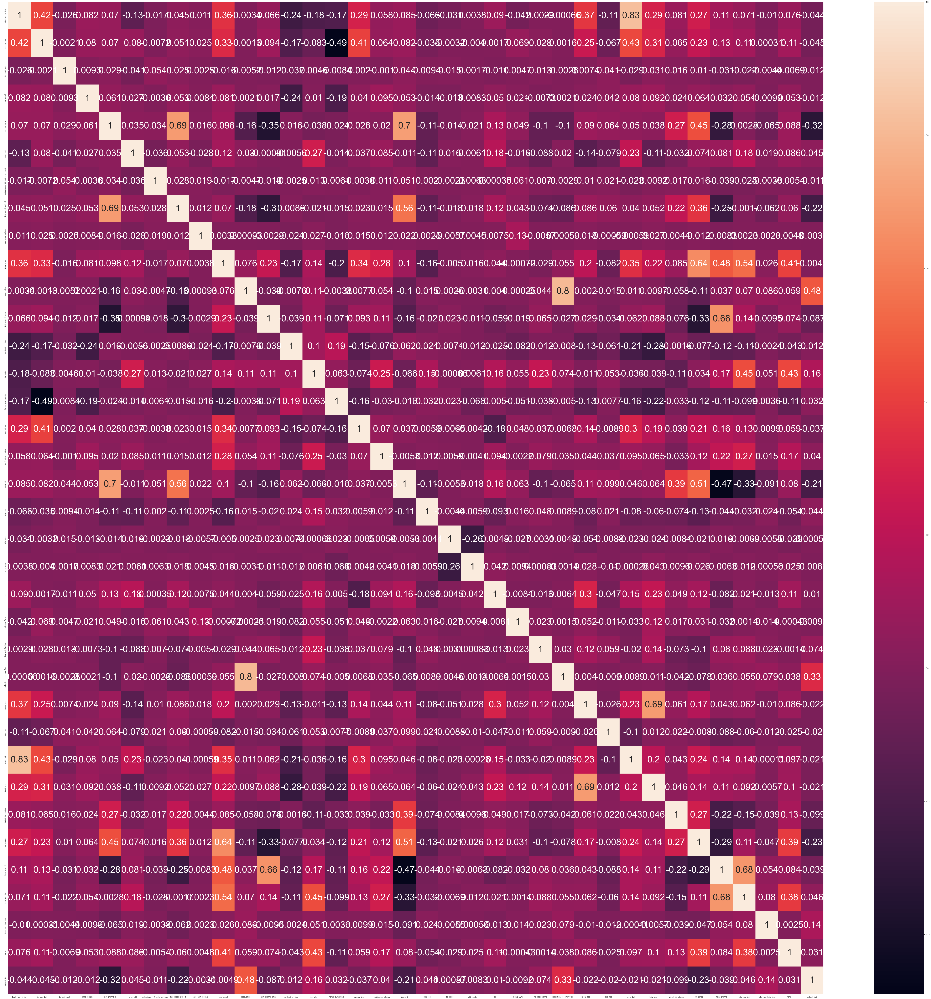

In [295]:
fig, ax = plt.subplots(figsize=(100,100))
sns.set(font_scale = 1)
sns.heatmap(df.corr(), 
        xticklabels=df.corr().columns,
        yticklabels=df.corr().columns,annot=True,ax=ax,annot_kws={"fontsize":50})

In [ ]:
#Core
df=df.drop(['funded_amnt','funded_amnt_inv','out_prncp_inv','total_pymnt_inv','id','member_id','total_rec_prncp'],axis=1)

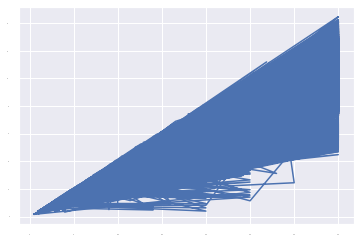

In [ ]:
fig,ax = plt.subplots(1)

# create some x data and some integers for the y axis
x = df['loan_amnt']
y = df['installment']

# plot the data
ax.plot(x,y)

In [ ]:
comp_df=df[['loan_amnt','installment']]

In [ ]:
comp_df['division']=comp_df['loan_amnt']/comp_df['installment']

<ipython-input-34-f1d02da25db7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  comp_df['division']=comp_df['loan_amnt']/comp_df['installment']


In [ ]:
comp_df

,loan_amnt,installment,division
0,5000.0,162.87,30.699331
1,2500.0,59.83,41.785058
2,2400.0,84.33,28.459623
3,10000.0,339.31,29.471575
4,3000.0,67.79,44.254315
...,...,...,...
855964,10000.0,332.10,30.111412
855965,24000.0,797.03,30.111790
855966,13000.0,316.07,41.130129
855967,12000.0,317.86,37.752470


In [ ]:
comp_df['division'].describe()

count    855969.000000
mean         33.554583
std           5.855275
min          23.865472
25%          29.600395
50%          31.368030
75%          37.751940
max         504.286435
Name: division, dtype: float64

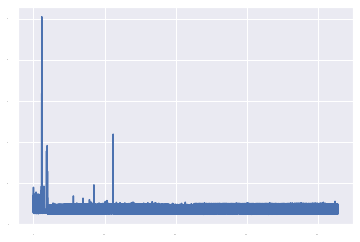

In [ ]:
plt.plot(comp_df['division'])

C:\Users\mmoy\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='division', ylabel='Density'>

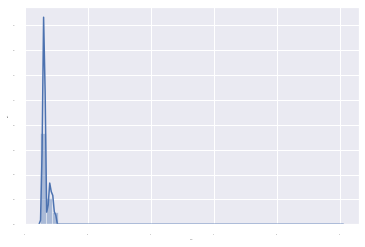

In [ ]:
sns.distplot(comp_df['division'])

In [ ]:
#Core
df=df.drop('installment',axis=1)

In [ ]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

next_pymnt_d                  29.553757
tot_cur_bal                    7.863953
tot_coll_amt                   7.863953
total_rev_hi_lim               7.863953
emp_title                      5.776261
emp_length                     5.030673
last_pymnt_d                   1.035318
revol_util                     0.052105
collections_12_mths_ex_med     0.006542
last_credit_pull_d             0.005841
title                          0.003855
int_rate                       0.000000
purpose                        0.000000
pymnt_plan                     0.000000
issue_d                        0.000000
verification_status            0.000000
annual_inc                     0.000000
home_ownership                 0.000000
default_ind                    0.000000
sub_grade                      0.000000
grade                          0.000000
earliest_cr_line               0.000000
inq_last_6mths                 0.000000
recoveries                     0.000000
open_acc                       0.000000


In [ ]:
correl=df.corr()
correl

,tot_cur_bal,tot_coll_amt,total_rev_hi_lim,revol_util,collections_12_mths_ex_med,annual_inc,default_ind,int_rate,loan_amnt,total_pymnt,dti,delinq_2yrs,acc_now_delinq,last_pymnt_amnt,collection_recovery_fee,recoveries,total_rec_late_fee,total_rec_int,out_prncp,total_acc,revol_bal,pub_rec,open_acc,inq_last_6mths
tot_cur_bal,1.000000,-0.000331,0.384867,0.080583,-0.010622,0.422618,-0.036335,-0.091430,0.329130,0.169289,-0.007133,0.064618,0.022804,0.103113,0.005704,0.004063,0.008831,0.134022,0.207565,0.311268,0.443059,-0.075956,0.244465,0.034806
tot_coll_amt,-0.000331,1.000000,-0.005025,-0.009252,0.009686,0.001005,-0.001921,0.001129,-0.004272,-0.004203,-0.001995,0.000154,0.000267,-0.002568,-0.000514,-0.000919,-0.000592,-0.003562,-0.000840,0.006463,-0.006117,0.006816,0.000071,0.003181
total_rev_hi_lim,0.384867,-0.005025,1.000000,-0.117724,-0.016808,0.271059,-0.033620,-0.165533,0.312072,0.120593,0.032430,-0.040575,0.008254,0.062068,0.001399,-0.000171,-0.005545,0.073855,0.221319,0.255391,0.820800,-0.100227,0.325179,0.006089
revol_util,0.080583,-0.009252,-0.117724,1.000000,-0.035707,0.036753,0.044497,0.271687,0.119635,0.080945,0.086649,-0.016299,-0.027270,-0.000939,0.019880,0.029601,0.019445,0.183754,0.074353,-0.114616,0.217785,-0.079050,-0.144959,-0.088353
collections_12_mths_ex_med,-0.010622,0.009686,-0.016808,-0.035707,1.000000,-0.003789,-0.010650,0.012841,-0.017042,-0.038618,-0.000117,0.063019,0.040197,-0.017771,-0.002866,-0.004684,-0.003835,-0.024670,0.015653,0.009181,-0.022552,0.020874,0.009998,0.007364
annual_inc,0.422618,0.001005,0.271059,0.036753,-0.003789,1.000000,-0.037066,-0.073825,0.335209,0.163226,-0.086821,0.047749,0.014877,0.092662,0.006805,0.007613,0.009864,0.130367,0.211549,0.188651,0.298569,-0.008909,0.139429,0.037251
default_ind,-0.036335,-0.001921,-0.033620,0.044497,-0.010650,-0.037066,1.000000,0.155037,-0.004907,-0.039220,0.004429,-0.009186,-0.003116,-0.087217,0.330764,0.475738,0.140760,0.046050,-0.225960,-0.021087,-0.020696,-0.019607,-0.021698,0.074407
int_rate,-0.091430,0.001129,-0.165533,0.271687,0.012841,-0.073825,0.155037,1.000000,0.142966,0.173387,0.078454,0.055400,0.026476,0.107346,0.074360,0.110848,0.050743,0.446517,0.033933,-0.039482,-0.035344,0.052596,-0.011091,0.231705
loan_amnt,0.329130,-0.004272,0.312072,0.119635,-0.017042,0.335209,-0.004907,0.142966,1.000000,0.479612,0.020189,-0.000739,0.003572,0.233596,0.055135,0.075513,0.025966,0.537586,0.639784,0.222084,0.337489,-0.082199,0.198926,-0.028928
total_pymnt,0.169289,-0.004203,0.120593,0.080945,-0.038618,0.163226,-0.039220,0.173387,0.479612,1.000000,-0.040537,-0.031777,-0.008220,0.662738,0.035844,0.037201,0.054403,0.679127,-0.289173,0.110169,0.139161,-0.087933,0.043452,0.080476


In [ ]:
df.head(200)

,next_pymnt_d,tot_cur_bal,tot_coll_amt,total_rev_hi_lim,emp_title,emp_length,last_pymnt_d,revol_util,collections_12_mths_ex_med,last_credit_pull_d,title,purpose,pymnt_plan,issue_d,verification_status,annual_inc,home_ownership,default_ind,sub_grade,grade,int_rate,term,addr_state,loan_amnt,zip_code,total_pymnt,dti,delinq_2yrs,acc_now_delinq,application_type,last_pymnt_amnt,collection_recovery_fee,recoveries,total_rec_late_fee,total_rec_int,out_prncp,initial_list_status,total_acc,revol_bal,pub_rec,open_acc,inq_last_6mths,earliest_cr_line
0,NaN,NaN,NaN,NaN,NaN,10+ years,Jan-2015,83.7,0.0,Jan-2016,Computer,credit_card,n,Dec-2011,Verified,24000.0,RENT,0,B2,B,10.65,36 months,AZ,5000.0,860xx,5861.071414,27.65,0.0,0.0,INDIVIDUAL,171.62,0.00,0.00,0.00,861.07,0.0,f,9.0,13648.0,0.0,3.0,1.0,Jan-1985
1,NaN,NaN,NaN,NaN,Ryder,< 1 year,Apr-2013,9.4,0.0,Sep-2013,bike,car,n,Dec-2011,Source Verified,30000.0,RENT,1,C4,C,15.27,60 months,GA,2500.0,309xx,1008.710000,1.00,0.0,0.0,INDIVIDUAL,119.66,1.11,117.08,0.00,435.17,0.0,f,4.0,1687.0,0.0,3.0,5.0,Apr-1999
2,NaN,NaN,NaN,NaN,NaN,10+ years,Jun-2014,98.5,0.0,Jan-2016,real estate business,small_business,n,Dec-2011,Not Verified,12252.0,RENT,0,C5,C,15.96,36 months,IL,2400.0,606xx,3003.653644,8.72,0.0,0.0,INDIVIDUAL,649.91,0.00,0.00,0.00,603.65,0.0,f,10.0,2956.0,0.0,2.0,2.0,Nov-2001
3,NaN,NaN,NaN,NaN,AIR RESOURCES BOARD,10+ years,Jan-2015,21.0,0.0,Jan-2015,personel,other,n,Dec-2011,Source Verified,49200.0,RENT,0,C1,C,13.49,36 months,CA,10000.0,917xx,12226.302212,20.00,0.0,0.0,INDIVIDUAL,357.48,0.00,0.00,16.97,2209.33,0.0,f,37.0,5598.0,0.0,10.0,1.0,Feb-1996
4,Feb-2016,NaN,NaN,NaN,University Medical Group,1 year,Jan-2016,53.9,0.0,Jan-2016,Personal,other,n,Dec-2011,Source Verified,80000.0,RENT,0,B5,B,12.69,60 months,OR,3000.0,972xx,3242.170000,17.94,0.0,0.0,INDIVIDUAL,67.79,0.00,0.00,0.00,1009.07,766.9,f,38.0,27783.0,0.0,15.0,0.0,Jan-1996
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,NaN,NaN,NaN,NaN,Corning Inc.,8 years,Oct-2012,86.2,0.0,Feb-2013,Debt Consolidation Loan,other,n,Dec-2011,Not Verified,70000.0,MORTGAGE,1,C2,C,14.27,36 months,NY,12000.0,148xx,4241.160000,8.40,0.0,0.0,INDIVIDUAL,411.71,5.32,543.42,0.00,1163.48,0.0,f,12.0,11546.0,0.0,7.0,1.0,Aug-2005
196,NaN,NaN,NaN,NaN,UPS,10+ years,Sep-2014,89.1,0.0,Aug-2014,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Verified,100000.0,MORTGAGE,0,B3,B,11.71,36 months,RI,25000.0,028xx,29277.573837,6.88,0.0,0.0,INDIVIDUAL,1122.55,0.00,0.00,0.00,4277.57,0.0,f,18.0,21128.0,0.0,8.0,1.0,Dec-1986
197,NaN,NaN,NaN,NaN,Gilbert Express,5 years,Jan-2015,55.4,0.0,Sep-2015,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Source Verified,50000.0,RENT,0,B5,B,12.69,36 months,NY,9000.0,115xx,10867.209977,17.81,0.0,0.0,INDIVIDUAL,306.11,0.00,0.00,0.00,1867.21,0.0,f,21.0,12752.0,0.0,13.0,1.0,Dec-2001
198,NaN,NaN,NaN,NaN,Talbert House,4 years,Jan-2015,58.7,0.0,Jan-2016,Debt Consolidation Loan,debt_consolidation,n,Dec-2011,Not Verified,35000.0,RENT,0,B2,B,10.65,36 months,OH,13250.0,450xx,15535.931858,24.93,0.0,0.0,INDIVIDUAL,437.68,0.00,0.00,0.00,2285.93,0.0,f,25.0,13392.0,0.0,11.0,2.0,Oct-2002


In [ ]:
#df.to_csv('attempt1')

In [ ]:
col=df.columns
for col in df[col]:
    print(col, ' ' ,df[[col]].value_counts())

next_pymnt_d   next_pymnt_d
Feb-2016        534094
Jan-2016         68838
Mar-2016            66
dtype: int64
tot_cur_bal   tot_cur_bal
0.0            121
22396.0         21
27316.0         20
34574.0         20
29232.0         20
              ... 
263542.0         1
263541.0         1
263538.0         1
263537.0         1
186014.0         1
Length: 322286, dtype: int64
tot_coll_amt   tot_coll_amt
0.0             677062
50.0              1688
100.0             1307
75.0               998
200.0              688
                 ...  
8707.0               1
8706.0               1
3528.0               1
3529.0               1
9152545.0            1
Length: 10138, dtype: int64
total_rev_hi_lim   total_rev_hi_lim
15000.0             2554
10000.0             2525
12000.0             2519
13000.0             2507
14500.0             2502
                    ... 
52847.0                1
52829.0                1
52821.0                1
52820.0                1
43210.0                1
Length

last_pymnt_amnt   last_pymnt_amnt
0.00               8867
327.34             2053
318.79             1767
312.86             1437
392.81             1374
                   ... 
7849.40               1
7849.37               1
7849.27               1
7849.24               1
4301.46               1
Length: 230321, dtype: int64
collection_recovery_fee   collection_recovery_fee
0.0000                     832934
2.0000                         15
4.5200                         11
2.5200                         11
1.8800                         11
                            ...  
177.8382                        1
177.8508                        1
177.9322                        1
177.9498                        1
33.5991                         1
Length: 20529, dtype: int64
recoveries   recoveries
0.00          831782
200.00            10
14.28              9
11.70              9
10.00              8
               ...  
1917.87            1
1918.14            1
1918.74            1
1918.82 

In [ ]:
#To Explore

#pymnt_plan 
#application_type

In [ ]:
df['pymnt_plan'].value_counts()

n    855964
y         5
Name: pymnt_plan, dtype: int64

In [ ]:
df['application_type'].value_counts()

INDIVIDUAL    855527
JOINT            442
Name: application_type, dtype: int64

In [ ]:
df['default_ind'].value_counts()

0    809502
1     46467
Name: default_ind, dtype: int64

In [ ]:
df['next_pymnt_d'].value_counts()

Feb-2016    534094
Jan-2016     68838
Mar-2016        66
Name: next_pymnt_d, dtype: int64

In [ ]:
#Core
df=df.drop(['pymnt_plan','application_type','next_pymnt_d'],axis=1)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 855969 entries, 0 to 855968
Data columns (total 40 columns):
 #   Column                      Non-Null Count   Dtype  
---  ------                      --------------   -----  
 0   tot_cur_bal                 788656 non-null  float64
 1   tot_coll_amt                788656 non-null  float64
 2   total_rev_hi_lim            788656 non-null  float64
 3   emp_title                   806526 non-null  object 
 4   emp_length                  812908 non-null  object 
 5   last_pymnt_d                847107 non-null  object 
 6   revol_util                  855523 non-null  float64
 7   collections_12_mths_ex_med  855913 non-null  float64
 8   last_credit_pull_d          855919 non-null  object 
 9   title                       855936 non-null  object 
 10  purpose                     855969 non-null  object 
 11  issue_d                     855969 non-null  object 
 12  verification_status         855969 non-null  object 
 13  annual_inc    

In [ ]:
#Types of Attributes that are not floats/integers

#categorical

#empt_title DROPPED
#emp_length CHANGED
#title DROPPED
#purpose
#verification_status
#pymnt_plan
#home_ownership
#sub_grade
#grade
#term CHANGED
#addr_state
#zip_code DROPPED
#application_type
#initial_list_status


#date

#next_pymnt_d DROPPED
#last_pymnt_d
#last_credit_pull_d
#issue_d IMPORTANT FOR TR/TS SPLIT DONT TOUCH
#earliest_cr_line

#y
#default_ind

In [ ]:
df['emp_length'].value_counts()

10+ years    282090
2 years       75986
< 1 year      67597
3 years       67392
1 year        54855
5 years       53812
4 years       50643
7 years       43204
8 years       42421
6 years       41446
9 years       33462
Name: emp_length, dtype: int64

In [ ]:
df['term'].value_counts()

 36 months    600221
 60 months    255748
Name: term, dtype: int64

In [ ]:
#Core
df['emp_length']=df['emp_length'].str.replace('[A-Za-z\s+<>]+', '')
df['term']=df['term'].str.replace('[A-Za-z\s+<>]+', '').astype('int')

In [ ]:
nullity=(df.isnull().sum()/len(df)*100).sort_values(ascending=False)
nullity

tot_cur_bal                   7.863953
tot_coll_amt                  7.863953
total_rev_hi_lim              7.863953
emp_title                     5.776261
emp_length                    5.030673
last_pymnt_d                  1.035318
revol_util                    0.052105
collections_12_mths_ex_med    0.006542
last_credit_pull_d            0.005841
title                         0.003855
inq_last_6mths                0.000000
purpose                       0.000000
issue_d                       0.000000
verification_status           0.000000
annual_inc                    0.000000
home_ownership                0.000000
default_ind                   0.000000
sub_grade                     0.000000
grade                         0.000000
int_rate                      0.000000
earliest_cr_line              0.000000
addr_state                    0.000000
total_rec_late_fee            0.000000
open_acc                      0.000000
pub_rec                       0.000000
revol_bal                

In [ ]:
df['title'].value_counts()

Debt consolidation                                                                  398089
Credit card refinancing                                                             159228
Home improvement                                                                     38633
Other                                                                                30522
Debt Consolidation                                                                   15469
Major purchase                                                                       11519
Medical expenses                                                                      6408
Business                                                                              6325
Car financing                                                                         5372
Consolidation                                                                         5266
debt consolidation                                                                    4718

In [ ]:
df['emp_title'].value_counts()

Teacher                                                                           12965
Manager                                                                           10821
Registered Nurse                                                                   5341
RN                                                                                 5182
Owner                                                                              5157
Supervisor                                                                         4792
Sales                                                                              4051
Project Manager                                                                    3856
Driver                                                                             3417
Office Manager                                                                     3404
Director                                                                           3067
General Manager                 

In [ ]:
#Core
df=df.drop(['title','emp_title'],axis=1)

In [ ]:
df['zip_code'].value_counts()

945xx    9466
750xx    9111
112xx    8894
606xx    8370
300xx    7820
100xx    7348
070xx    7143
331xx    7139
900xx    7022
770xx    6657
891xx    6193
917xx    6140
330xx    6021
117xx    5885
104xx    5732
921xx    5463
852xx    5257
926xx    5227
913xx    4989
925xx    4752
113xx    4633
334xx    4573
481xx    4491
601xx    4446
021xx    4389
600xx    4387
604xx    4381
080xx    4377
956xx    4191
980xx    4145
920xx    4145
853xx    4099
941xx    4074
928xx    4042
301xx    4024
802xx    4011
760xx    3982
773xx    3958
201xx    3875
207xx    3819
774xx    3799
850xx    3787
951xx    3665
902xx    3598
088xx    3570
923xx    3552
480xx    3547
212xx    3514
782xx    3440
554xx    3390
553xx    3379
275xx    3364
800xx    3339
114xx    3326
333xx    3292
752xx    3250
940xx    3194
605xx    3178
787xx    3163
303xx    3136
953xx    3127
786xx    3102
327xx    3096
840xx    3048
328xx    3034
958xx    3032
775xx    3000
967xx    2981
191xx    2955
441xx    2921
890xx    2917
483xx 

In [ ]:
#Core
df.drop('zip_code',axis=1)

In [ ]:
df['addr_state'].value_counts()

CA    125172
NY     71114
TX     68708
FL     58639
IL     34379
NJ     32061
PA     30250
OH     28651
GA     28043
VA     25234
NC     23787
MI     22175
MD     20209
MA     19835
AZ     19693
WA     18816
CO     18211
MN     15424
MO     13743
IN     13348
CT     13042
TN     12392
NV     11972
WI     11199
AL     10732
OR     10562
SC     10302
LA     10186
KY      8299
OK      7759
KS      7693
AR      6399
UT      6055
NM      4757
HI      4380
WV      4247
NH      4156
RI      3753
MS      3653
MT      2466
DE      2402
DC      2382
AK      2134
WY      1974
VT      1753
SD      1745
NE      1124
ME       491
ND       452
ID         9
IA         7
Name: addr_state, dtype: int64

In [ ]:
df['grade'].value_counts()

B    247998
C    236855
A    145665
D    132802
E     66448
F     21328
G      4873
Name: grade, dtype: int64

In [ ]:
df['sub_grade'].value_counts()

B3    54958
B4    54116
C1    51588
C2    50457
C3    48337
B2    47589
B5    47333
C4    46941
B1    44002
A5    43957
C5    39532
D1    34667
A4    33991
D2    28385
D3    25289
D4    24253
A3    23095
A1    22516
A2    22106
D5    20208
E1    17230
E2    15994
E3    13294
E4    11011
E5     8919
F1     6702
F2     4979
F3     4099
F4     3168
F5     2380
G1     1698
G2     1259
G3      877
G4      570
G5      469
Name: sub_grade, dtype: int64

In [ ]:
df[df['grade']=='G']['sub_grade'].value_counts()

G1    1698
G2    1259
G3     877
G4     570
G5     469
Name: sub_grade, dtype: int64

In [ ]:
#Core
df.drop('grade',axis=1)
##g

In [ ]:
df['last_pymnt_d']

0         Jan-2015
1         Apr-2013
2         Jun-2014
3         Jan-2015
4         Jan-2016
            ...   
855964    Jan-2016
855965    Jan-2016
855966    Jan-2016
855967    Jan-2016
855968    Jan-2016
Name: last_pymnt_d, Length: 855969, dtype: object

In [ ]:
date_cols=['last_pymnt_d','last_credit_pull_d','issue_d','earliest_cr_line']
for col in date_cols:
    df[col]=pd.to_datetime(df[col]).dt.strftime('%Y%m%d').astype(float)
df[['last_pymnt_d','last_credit_pull_d','issue_d','earliest_cr_line']]

,last_pymnt_d,last_credit_pull_d,issue_d,earliest_cr_line
0,19700101.0,20160101.0,20111201.0,19850101.0
1,19700101.0,20130901.0,20111201.0,19990401.0
2,19700101.0,20160101.0,20111201.0,20011101.0
3,19700101.0,20150101.0,20111201.0,19960201.0
4,19700101.0,20160101.0,20111201.0,19960101.0
...,...,...,...,...
855964,19700101.0,20160101.0,20150101.0,20040901.0
855965,19700101.0,20160101.0,20150101.0,19740301.0
855966,19700101.0,20160101.0,20150101.0,20030901.0
855967,19700101.0,20160101.0,20150101.0,20031001.0


In [ ]:
df['last_pymnt_d'].unique()

array([20150101., 20130401., 20140601., 20160101., 20120401., 20121101.,
       20130601., 20130901., 20120701., 20131001., 20130501., 20150201.,
       20150801., 20121001., 20120901.,       nan, 20121201., 20141201.,
       20130801., 20131101., 20140101., 20140401., 20140801., 20141001.,
       20120801., 20140701., 20130701., 20150401., 20140201., 20140901.,
       20120601., 20130201., 20130301., 20140501., 20150301., 20130101.,
       20131201., 20120201., 20140301., 20150901., 20151101., 20151201.,
       20120101., 20151001., 20141101., 20120301., 20120501., 20150601.,
       20150501., 20150701., 20111201., 20111101., 20111001., 20110901.,
       20110801., 20110701., 20110601., 20110501., 20110401., 20110301.,
       20110201., 20110101., 20101201., 20101101., 20101001., 20100901.,
       20100801., 20100701., 20100601., 20100501., 20100401., 20100301.,
       20100201., 20100101., 20091201., 20091101., 20091001., 20090901.,
       20090801., 20090701., 20090601., 20090501., 

In [66]:
df['last_pymnt_d'].value_counts()

Jan-2016    467510
Dec-2015    142783
Jul-2015     14472
Aug-2015     13010
Oct-2015     12503
             ...  
Jun-2008        10
Nov-2008        10
Mar-2008         5
Jan-2008         4
Feb-2008         1
Name: last_pymnt_d, Length: 97, dtype: int64

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='last_pymnt_d', ylabel='Density'>

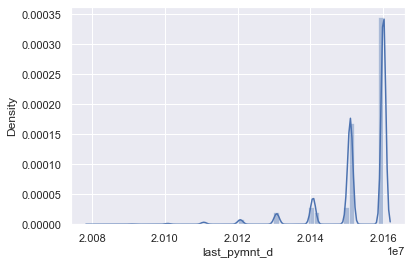

In [69]:
sns.distplot(df['last_pymnt_d'])

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='emp_length', ylabel='Density'>

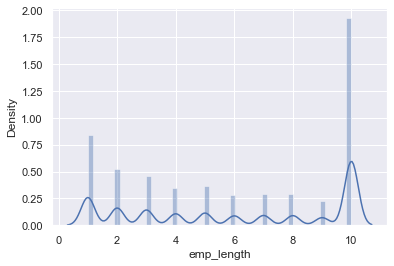

In [85]:
sns.distplot(df['emp_length'])

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='last_credit_pull_d', ylabel='Density'>

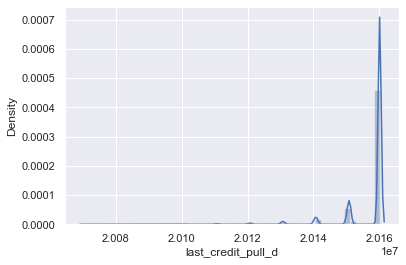

In [95]:
sns.distplot(df['last_credit_pull_d'])

In [84]:
df['emp_length'].value_counts()

10.0    282090
1.0     122452
2.0      75986
3.0      67392
5.0      53812
4.0      50643
7.0      43204
8.0      42421
6.0      41446
9.0      33462
Name: emp_length, dtype: int64

In [94]:
df['last_credit_pull_d'].value_counts()

20160101.0    701687
20151201.0     19039
20151101.0     11388
20151001.0     10290
20150901.0      9985
               ...  
20080501.0         1
20080601.0         1
20080701.0         1
20070501.0         1
20070701.0         1
Name: last_credit_pull_d, Length: 102, dtype: int64

In [77]:
df['total_rev_hi_lim'].mean()

32163.5745255219

In [78]:
df['total_rev_hi_lim'].median()

23800.0

In [81]:
lis=[1,2,2,3,4]
np.median(lis)

2.0

In [ ]:
#Null Replacement
#tot_cur_bal - median
#tot_coll_amt - median
#total_rev_hi_lim - median
#emp_length - mode
#last_pymnt_d - mode
#revol_utillist - median
#collections_12_mths_ex_med - mode
#last_credit_pull_d - mode


In [ ]:
med=['tot_cur_bal','tot_coll_amt','total_rev_hi_lim','revol_util']
mod=['emp_length','last_pymnt_d','collections_12_mths_ex_med','last_credit_pull_d']
for col in med:
    df[col]=df[col].fillna(df[col].median())

for col in mod:
    df[col]=df[col].fillna(df[col].mode()[0])

In [31]:
df['zip_code'].value_counts()

945xx    9466
750xx    9111
112xx    8894
606xx    8370
300xx    7820
         ... 
503xx       1
889xx       1
524xx       1
888xx       1
507xx       1
Name: zip_code, Length: 931, dtype: int64

In [33]:
df['addr_state'].value_counts()

CA    125172
NY     71114
TX     68708
FL     58639
IL     34379
NJ     32061
PA     30250
OH     28651
GA     28043
VA     25234
NC     23787
MI     22175
MD     20209
MA     19835
AZ     19693
WA     18816
CO     18211
MN     15424
MO     13743
IN     13348
CT     13042
TN     12392
NV     11972
WI     11199
AL     10732
OR     10562
SC     10302
LA     10186
KY      8299
OK      7759
KS      7693
AR      6399
UT      6055
NM      4757
HI      4380
WV      4247
NH      4156
RI      3753
MS      3653
MT      2466
DE      2402
DC      2382
AK      2134
WY      1974
VT      1753
SD      1745
NE      1124
ME       491
ND       452
ID         9
IA         7
Name: addr_state, dtype: int64

In [ ]:
df['address'].value_counts()

In [34]:
df['address']=df['zip_code']+df['addr_state']

In [ ]:
df['zip_code']=df['zip_code'].str.replace('[A-Za-z\s+<>]+', '')
#df['address']=df['zip_code']+df['addr_state']

In [3]:
#empt_title DROPPED t
#emp_length CHANGED t
#title DROPPED t
#purpose t
#verification_status t
#pymnt_plan DROPPED t
#home_ownership t
#sub_grade (T) t
#grade DROPPED (T) t
#term CHANGED t 
#addr_state (T) t
#zip_code CHANGED (T) t
#application_type (T)
#initial_list_status t

In [27]:
df['initial_list_status'].value_counts()

f    442555
w    413414
Name: initial_list_status, dtype: int64

In [24]:
df['sub_grade'].value_counts()

B3    54958
B4    54116
C1    51588
C2    50457
C3    48337
B2    47589
B5    47333
C4    46941
B1    44002
A5    43957
C5    39532
D1    34667
A4    33991
D2    28385
D3    25289
D4    24253
A3    23095
A1    22516
A2    22106
D5    20208
E1    17230
E2    15994
E3    13294
E4    11011
E5     8919
F1     6702
F2     4979
F3     4099
F4     3168
F5     2380
G1     1698
G2     1259
G3      877
G4      570
G5      469
Name: sub_grade, dtype: int64

In [20]:
df['verification_status']=df['verification_status'].str.replace('Source Verified','Verified')

In [21]:
df['verification_status'].value_counts()

Verified        598227
Not Verified    257742
Name: verification_status, dtype: int64

In [4]:
df.columns

Index(['tot_cur_bal', 'total_rev_hi_lim', 'tot_coll_amt', 'emp_length',
       'last_pymnt_d', 'revol_util', 'collections_12_mths_ex_med',
       'last_credit_pull_d', 'acc_now_delinq', 'last_pymnt_amnt', 'loan_amnt',
       'recoveries', 'collection_recovery_fee', 'delinq_2yrs', 'int_rate',
       'sub_grade', 'home_ownership', 'annual_inc', 'verification_status',
       'issue_d', 'purpose', 'zip_code', 'addr_state', 'dti',
       'earliest_cr_line', 'term', 'inq_last_6mths', 'open_acc', 'pub_rec',
       'revol_bal', 'total_acc', 'initial_list_status', 'out_prncp',
       'total_pymnt', 'total_rec_int', 'total_rec_late_fee', 'default_ind'],
      dtype='object')

In [8]:
df['purpose'].value_counts()

2     505392
1     200144
4      49956
9      40949
6      16587
11      9785
0       8593
7       8193
8       5160
12      4542
5       3513
13      2280
10       549
3        326
Name: purpose, dtype: int64

In [38]:
df[['purpose','verification_status','home_ownership','sub_grade','initial_list_status','addr_state']]=df[['purpose','verification_status','home_ownership','sub_grade','initial_list_status','addr_state']].astype('category').cat.codes

AttributeError: 'DataFrame' object has no attribute 'cat'

In [44]:
cat_columns=['purpose','verification_status','home_ownership','sub_grade','initial_list_status','addr_state']
df[cat_columns] = df[cat_columns].astype('category').apply(lambda x: x.cat.codes)

In [47]:
df['int_rate'].value_counts()

10.99    34056
9.17     24956
15.61    24359
9.99     21315
7.89     20062
         ...  
24.40        1
18.72        1
26.99        1
16.01        1
24.59        1
Name: int_rate, Length: 520, dtype: int64

In [ ]:
#Dropping Subgrade as highly correlated with int_rate
df=df.drop('sub_grade',axis=1)

In [313]:
df_clus=df[['grade','sub_grade','int_rate','default_ind']]

In [308]:
df

,grade,sub_grade,int_rate
0,1,6,10.65
1,2,13,15.27
2,2,14,15.96
3,2,10,13.49
4,1,9,12.69
...,...,...,...
855964,1,9,11.99
855965,1,9,11.99
855966,3,16,15.99
855967,4,22,19.99


In [314]:
correl_clus=df_clus.corr()
correl_clus

,grade,sub_grade,int_rate,default_ind
grade,1.000000,0.976346,0.954900,0.123658
sub_grade,0.976346,1.000000,0.978394,0.126925
int_rate,0.954900,0.978394,1.000000,0.155039
default_ind,0.123658,0.126925,0.155039,1.000000


In [334]:
df['rec_by_loan_amt']=df['recoveries']/df['loan_amnt']
df['rec_by_out_amt']=df['recoveries']/df['out_prncp']


In [326]:
df[df['recoveries']!=0]['rec_by_loan_amt'].describe()

count    24187.000000
mean         0.109070
std          0.093977
min          0.000196
25%          0.052171
50%          0.107208
75%          0.135850
max          1.220774
Name: rec_by_loan_amt, dtype: float64

In [338]:
tr=df[df['recoveries']!=0]['rec_by_out_amt']
tr[tr>1]

1         inf
8         inf
9         inf
12        inf
14        inf
         ... 
855055    inf
855257    inf
855548    inf
855710    inf
855883    inf
Name: rec_by_out_amt, Length: 24187, dtype: float64

<AxesSubplot:xlabel='rec_by_out_amt', ylabel='Count'>

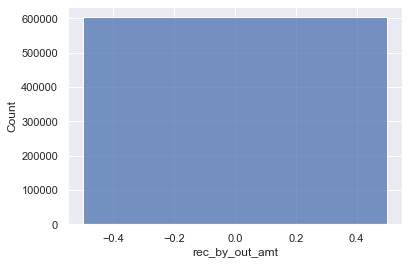

In [337]:
sns.histplot(df['rec_by_out_amt'])

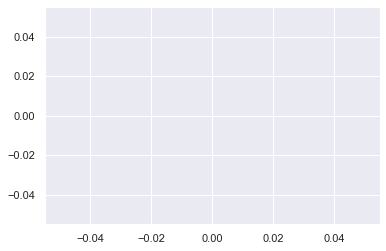

In [335]:
plt.plot(df[df['recoveries']!=0]['rec_by_out_amt'])

In [329]:
df[df['recoveries']!=0]['rec_by_out_amt'].describe()

c:\Users\mmoy\Documents\XYZ Corp\xyz_corp_venv\lib\site-packages\numpy\lib\function_base.py:4486: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


count    24187.0
mean         inf
std          NaN
min          inf
25%          NaN
50%          NaN
75%          NaN
max          inf
Name: rec_by_out_amt, dtype: float64

In [328]:
df[df['recoveries']!=0]['recoveries'].describe()

count    24187.000000
mean      1666.479998
std       1828.059251
min          3.600000
25%        480.440000
50%       1146.750000
75%       2326.755000
max      33520.270000
Name: recoveries, dtype: float64

In [332]:
df[df['recoveries']!=0]['out_prncp'].describe()

count    24187.0
mean         0.0
std          0.0
min          0.0
25%          0.0
50%          0.0
75%          0.0
max          0.0
Name: out_prncp, dtype: float64